**Import Libraries**

In [16]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sb
import plotly.express as pl
import folium
from folium.plugins import MarkerCluster
from folium.plugins import HeatMap
import warnings
warnings.filterwarnings("ignore")


**Read CSV File**

In [18]:
df = pd.read_csv("../Project/airinb_n.csv")

**Call Data Frame**

In [21]:
df

,Unnamed: 0,id,NAME,host_id,host_identity_verified,host_name,neighbourhood_group,neighbourhood,lat,long,...,price,service_fee,min_nights,number_of_reviews,last_review,reviews_per_month,review_rate_number,calculated_host_listings_count,availability_365,house_rules
0,0,1001254,Clean & quiet apt home by the park,80014485718,unconfirmed,Madaline,Brooklyn,Kensington,40.64749,-73.97237,...,966,193,10,9,2021-10-19,0,4,6,286,Clean up and treat the home the way you'd like...
1,1,1002102,Skylit Midtown Castle,52335172823,verified,Jenna,Manhattan,Midtown,40.75362,-73.98377,...,142,28,30,45,2022-05-21,0,4,2,228,Pet friendly but please confirm with me if the...
2,2,1002403,THE VILLAGE OF HARLEM....NEW YORK !,78829239556,unconfirmed,Elise,Manhattan,Harlem,40.80902,-73.94190,...,620,124,3,0,NaN,0,5,1,352,"I encourage you to use my kitchen, cooking and..."
3,4,1003689,Entire Apt: Spacious Studio/Loft by central park,92037596077,verified,Lyndon,Manhattan,East Harlem,40.79851,-73.94399,...,204,41,10,9,2018-11-19,0,3,1,289,"Please no smoking in the house, porch or on th..."
4,5,1004098,Large Cozy 1 BR Apartment In Midtown East,45498551794,verified,Michelle,Manhattan,Murray Hill,40.74767,-73.97500,...,577,115,3,74,2019-06-22,0,3,1,374,"No smoking, please, and no drugs."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
102324,102594,6092437,Spare room in Williamsburg,12312296767,verified,Krik,Brooklyn,Williamsburg,40.70862,-73.94651,...,844,169,1,0,NaN,0,3,1,227,No Smoking No Parties or Events of any kind Pl...
102325,102595,6092990,Best Location near Columbia U,77864383453,unconfirmed,Mifan,Manhattan,Morningside Heights,40.80460,-73.96545,...,837,167,1,1,2015-06-07,0,2,2,395,House rules: Guests agree to the following ter...
102326,102596,6093542,"Comfy, bright room in Brooklyn",69050334417,unconfirmed,Megan,Brooklyn,Park Slope,40.67505,-73.98045,...,988,198,3,0,NaN,0,5,1,342,no rule
102327,102597,6094094,Big Studio-One Stop from Midtown,11160591270,unconfirmed,Christopher,Queens,Long Island City,40.74989,-73.93777,...,546,109,2,5,2015-11-10,0,3,1,386,no rule


**Data Visualization Using Matplot Seaborn folium & Plotly**

['Brooklyn' 'Manhattan' 'Queens' 'Staten Island' 'Bronx']


neighbourhood_group: Manhattan


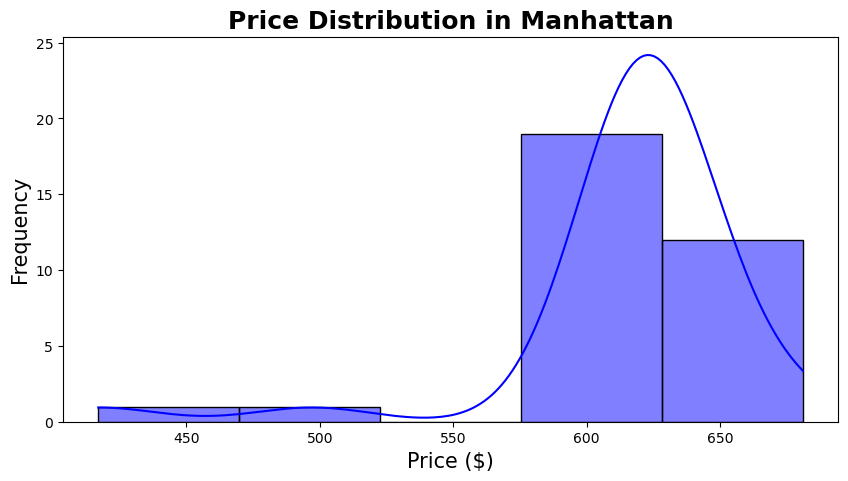

In [53]:
print(df.neighbourhood_group.unique())
ng=input("neighbourhood_group:")
result=df.groupby(['neighbourhood_group','neighbourhood'])['price'].mean().reset_index()
result1=result[result['neighbourhood_group']==ng]
result1
plt.figure(figsize=(10, 5))
sb.histplot(result1['price'], bins=5, kde=True, color='blue') 
plt.title(f"Price Distribution in {ng}", fontsize=18, fontweight="bold")
plt.xlabel("Price ($)",fontsize=15)
plt.ylabel("Frequency",fontsize=15)
plt.show()

*Analysis of price distribution by selecting a neighbourhood group and filtering the data accordingly*

In [56]:
ng_count = df.groupby('neighbourhood_group')['host_id'].count()

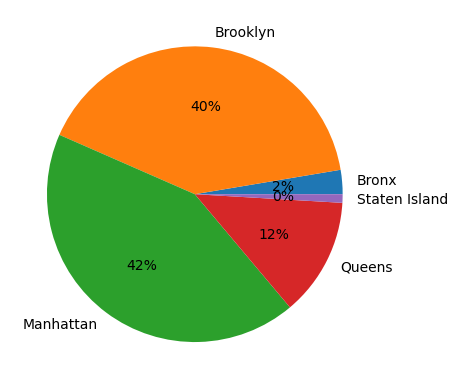

In [58]:
plt.pie(ng_count.values,labels = ng_count.index,autopct='%d%%')
plt.show()



*Manhattan (42%) and Brooklyn (40%) dominate – Together, they account for 82% of the total listings, indicating that these areas are the most popular for rentals*

*Queens (12%) has a smaller share – It serves as an alternative to the main hubs but has significantly fewer listings*

*Bronx (6%) and Staten Island (smallest portion) – These areas have the least number of listings, suggesting lower demand or availability*

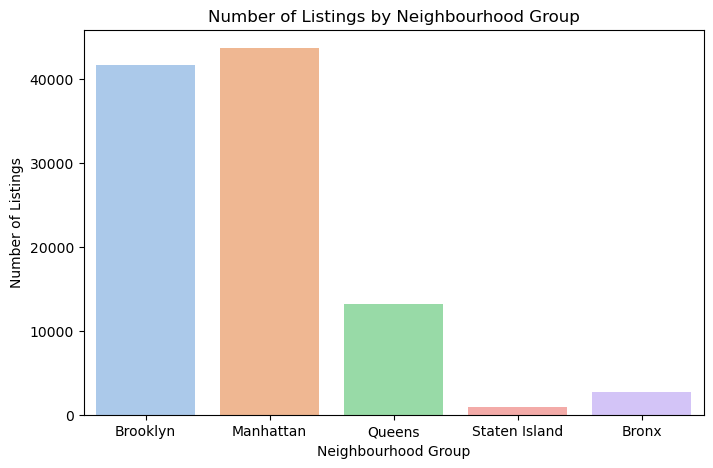

In [60]:
plt.figure(figsize=(8, 5))
sb.countplot(x='neighbourhood_group', data=df, palette='pastel')
plt.title('Number of Listings by Neighbourhood Group')
plt.xlabel('Neighbourhood Group')
plt.ylabel('Number of Listings')
plt.show()

*The chart shows that Manhattan and Brooklyn have the highest number of listings, making them the most popular areas. Queens has a moderate number, while Bronx and Staten Island have the least, indicating lower rental activity in these areas*

['Brooklyn' 'Manhattan' 'Queens' 'Staten Island' 'Bronx']


Neighbourhood Group :  Manhattan


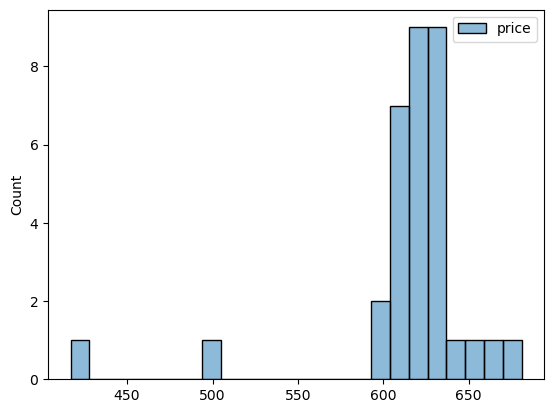

In [66]:
print(df.neighbourhood_group.unique())
ng = input("Neighbourhood Group : ")
result = df.groupby(['neighbourhood_group','neighbourhood'])['price'].mean().reset_index()
result1 = result[result['neighbourhood_group']==ng]
result1
sb.histplot(result1)
plt.show()

In [68]:
df.room_type.unique()

array(['Private room', 'Entire home/apt', 'Shared room', 'Hotel room'],
      dtype=object)

In [70]:
df.groupby('room_type')['price'].mean()

room_type
Entire home/apt    623.538255
Hotel room         668.465517
Private room       623.653324
Shared room        631.502252
Name: price, dtype: float64

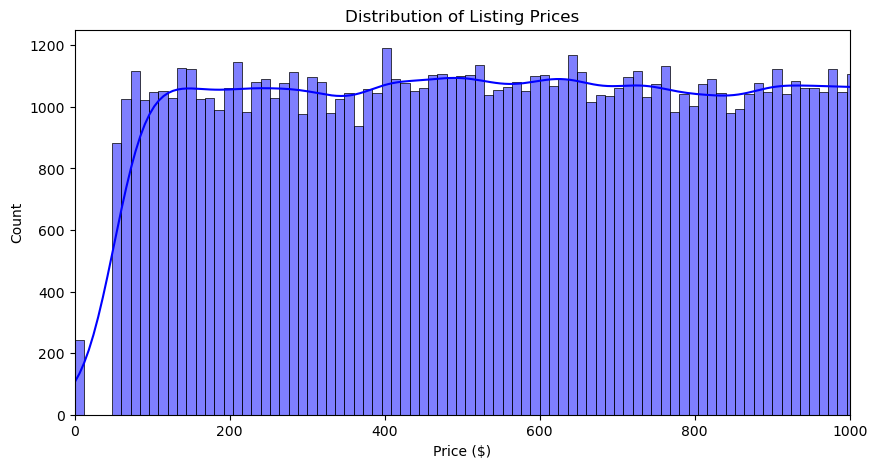

In [72]:
# Plot distribution of Price
plt.figure(figsize=(10, 5))
sb.histplot(df["price"], bins=100, kde=True, color="blue")
plt.xlim(0, 1000)  # Limit price to 1000 for better visualization
plt.title("Distribution of Listing Prices")
plt.xlabel("Price ($)")
plt.ylabel("Count")
plt.show()

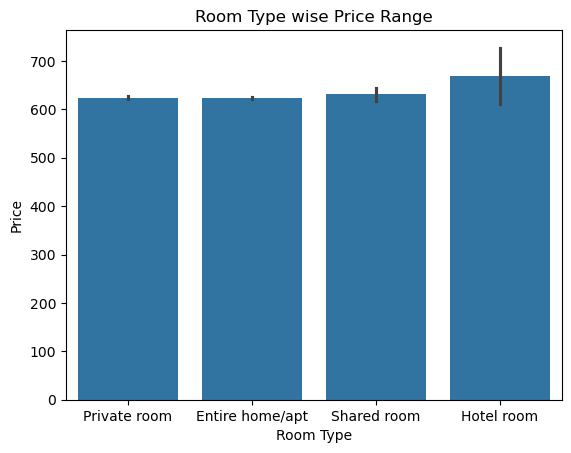

In [101]:
#Room type wise price range
sb.barplot(x=df.room_type,y=df.price,)
plt.title("Room Type wise Price Range")
plt.xlabel("Room Type")
plt.ylabel("Price")
plt.show()

**Price wise Room Type**

*This bar chart visualizes the average price for each room type in Airbnb listings*

*Hotel rooms have the highest average price, followed closely by entire home/apartments*

*Private rooms and shared rooms tend to be cheaper, with similar price ranges*

*The error bars suggest some variance in pricing, especially for hotel rooms*

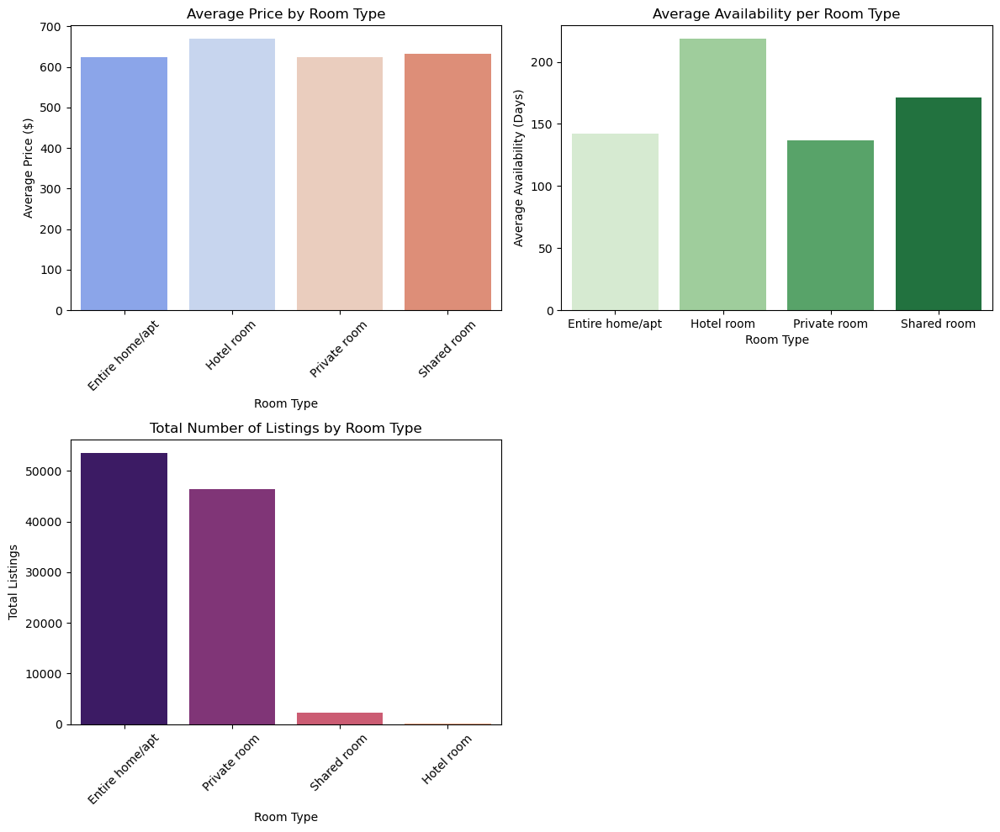

In [76]:
# Calculate the average price per room type
avg_price_by_roomtype = df.groupby("room_type")["price"].mean().reset_index()

# Bar Chart: Average Price by Room Type
plt.figure(figsize=(12, 10))
plt.subplot(2,2,1)
sb.barplot(x="room_type", y="price", data=avg_price_by_roomtype, palette="coolwarm")

plt.xlabel("Room Type")
plt.ylabel("Average Price ($)")
plt.title("Average Price by Room Type")
plt.xticks(rotation=45)


# Calculate average availability per room type
avg_availability = df.groupby("room_type")["availability_365"].mean().reset_index()

#Bar Chart: Average Availability per Room Type
plt.subplot(2, 2, 2)  
sb.barplot(x="room_type", y="availability_365", data=avg_availability, palette="Greens")
plt.xlabel("Room Type")
plt.ylabel("Average Availability (Days)")
plt.title("Average Availability per Room Type")

# Count total listings per room type
listing_counts = df['room_type'].value_counts().reset_index()
listing_counts.columns = ['room_type', 'total_listings']

# Bar Chart: Total Listings by Room Type
plt.subplot(2, 2, 3)
sb.barplot(x="room_type", y="total_listings", data=listing_counts, palette="magma")

# Labels and title
plt.xlabel("Room Type")
plt.ylabel("Total Listings")
plt.title("Total Number of Listings by Room Type")
plt.xticks(rotation=45)


plt.tight_layout()
plt.xticks(rotation=45)
plt.show()

**Average Price by Room Type**

*Entire home/apt and Hotel rooms have the highest average price (~$600-$650)*

*This is expected as these options offer full privacy and amenities*


*Private rooms are slightly cheaper (~$600)*

*They offer affordability while still providing privacy*


*Shared rooms have the lowest price (~$500)*

*Since guests share space with others, these are budget-friendly options*



**Average Availability per Room Type**

*Hotel rooms have the highest availability (~200 days/year)*

*Hotels operate year-round and are more consistently available*


*Shared rooms have higher availability 150 days than private rooms (120 days)*

*Shared accommodations are often rented out more frequently due to their lower cost*


*Entire homes/apartments have the lowest availability (~100 days)*

*These listings may be owner-occupied part of the year or used as vacation homes*


**Total Number of Listings by Room Type**

*The market is heavily skewed towards entire homes and private rooms, meaning hosts offering these spaces have a larger customer base*

*Shared rooms are a niche segment, indicating that travelers on Airbnb prefer more private accommodations than hostel-like setups*

*Hotel presence on Airbnb is minimal, so hotel chains might increase their listings to capture Airbnb’s audience*

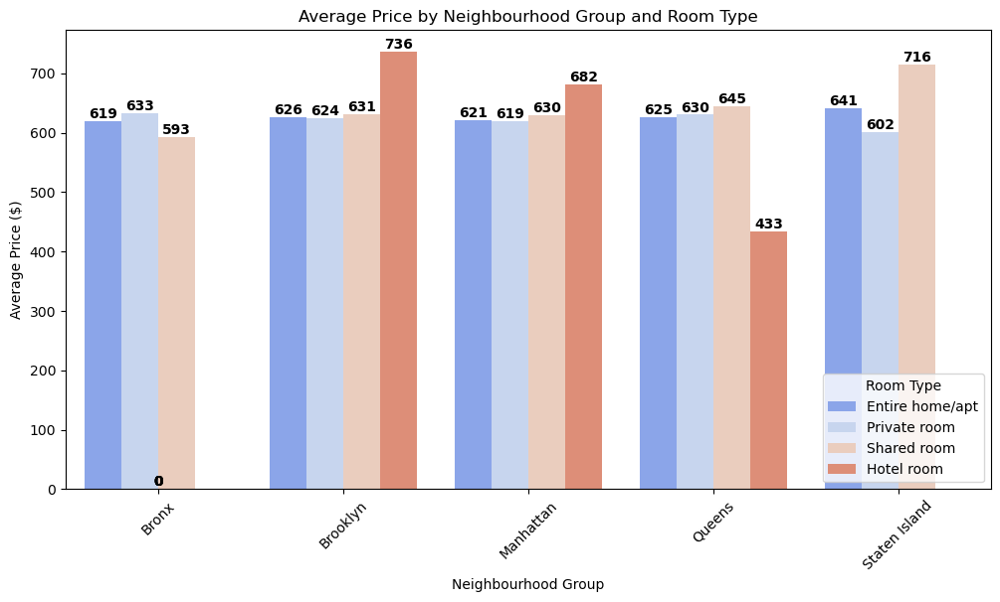

In [78]:
# Calculate the average price by neighborhood group and room type
avg_price = df.groupby(["neighbourhood_group", "room_type"])["price"].mean().reset_index()

# Create the grouped bar chart
plt.figure(figsize=(12, 6))
ax = sb.barplot(x="neighbourhood_group", y="price", hue="room_type", data=avg_price, palette="coolwarm")


for p in ax.patches:
    ax.annotate(
        f'{p.get_height():.0f}',  # Convert value to integer
        (p.get_x() + p.get_width() / 2, p.get_height()),  # Position
        ha="center", va="bottom",  # Alignment
        fontsize=10, fontweight="bold", color="black"
    )
    
# Labels and title
plt.xlabel("Neighbourhood Group")
plt.ylabel("Average Price ($)")
plt.title("Average Price by Neighbourhood Group and Room Type")
plt.legend(title="Room Type")
plt.xticks(rotation=45)
plt.show()

**Average Price by Neighbourhood Group and Room Type**

*Brooklyn has the highest average price ($736 for hotel rooms) after that Staten Island i.e 716*

*Manhattan hotel rooms are also expensive ($682), while other listings in Manhattan remain relatively stable*

*Bronx has the lowest average price overall, with shared rooms being the most affordable ($593)*

*Queens has the most affordable shared rooms ($433), making it a budget-friendly option*

*Hotel rooms are generally more expensive than other room types across all neighborhoods*

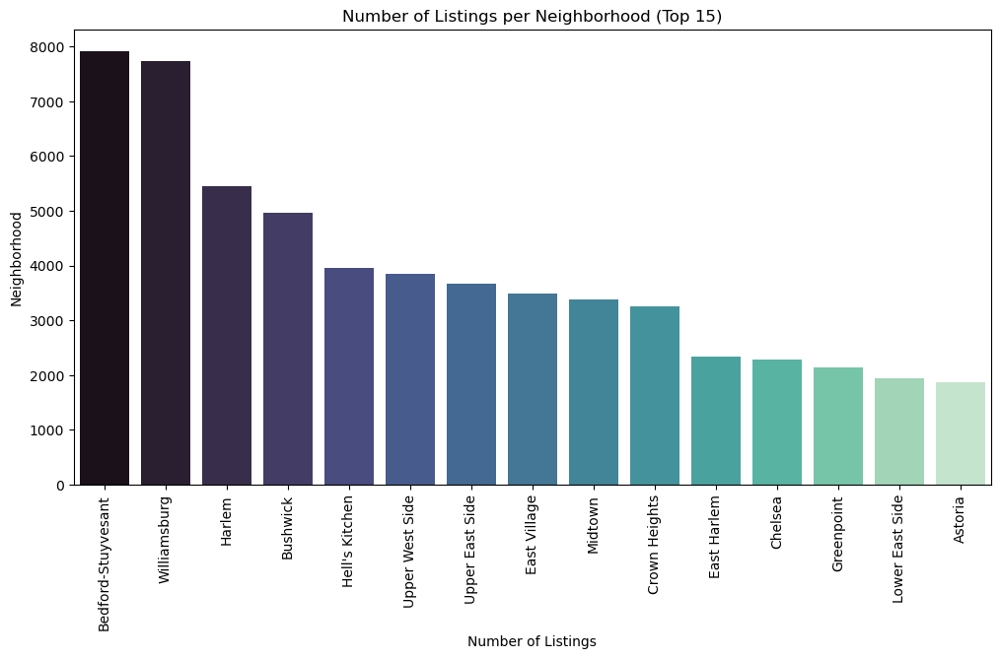

In [27]:
neighborhood_counts = df['neighbourhood'].value_counts().head(15)  # Top 15 neighborhoods

# Top neighborhood listing wise
plt.figure(figsize=(12, 6))
sb.barplot(y=neighborhood_counts.values, x=neighborhood_counts.index, palette="mako")

# Labels and title
plt.xlabel("Number of Listings")
plt.ylabel("Neighborhood")
plt.title("Number of Listings per Neighborhood (Top 15)")
plt.xticks(rotation=90)
plt.show()

**Number of Listings per Neighborhood (Top 15)**

*Brooklyn dominates with Bedford-Stuyvesant, Williamsburg, and Bushwick having the most listings*

*Manhattan remains a key rental hub with Harlem, Upper West/East Side, Midtown, East Village, and Chelsea contributing significantly*

*Queens (Astoria) appears, showing growing rental demand*

*The data highlights a mix of trendy, tourist-heavy, and residential neighborhoods in the short-term rental market*

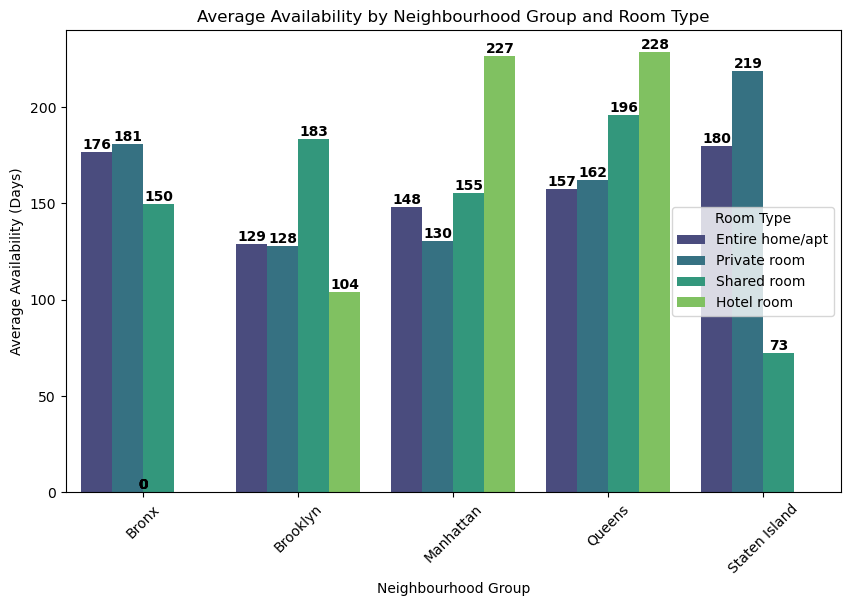

In [80]:
# Calculate the average availability by neighborhood group and room type
avg_availability = df.groupby(["neighbourhood_group", "room_type"])["availability_365"].mean().reset_index()

# Create the grouped bar chart
plt.figure(figsize=(10, 6))
ax = sb.barplot(x="neighbourhood_group", y="availability_365", hue="room_type", data=avg_availability, palette="viridis")

# Add labels on top of each bar

for p in ax.patches:
    ax.annotate(
        f'{p.get_height():.0f}',  # Convert value to integer
        (p.get_x() + p.get_width() / 2, p.get_height()),  # Position
        ha="center", va="bottom",  # Alignment
        fontsize=10, fontweight="bold", color="black"  
    )

# Labels and title
plt.xlabel("Neighbourhood Group")
plt.ylabel("Average Availability (Days)")
plt.title("Average Availability by Neighbourhood Group and Room Type")
plt.legend(title="Room Type")
plt.xticks(rotation=45)
plt.show()

**Average Availability by Room Type by Neighbourhood Group**

*Manhattan and Queens have the highest average availability, with hotel rooms available for 227 and 228 days on average, respectively*

*Staten Island has the lowest hotel room availability (73 days), making it the least available location*

*Brooklyn has relatively lower availability (around 129–183 days), suggesting higher occupancy*

*Hotel rooms generally have the highest availability across all neighborhoods, followed by shared rooms*

*Private rooms tend to have lower availability, likely due to higher demand*



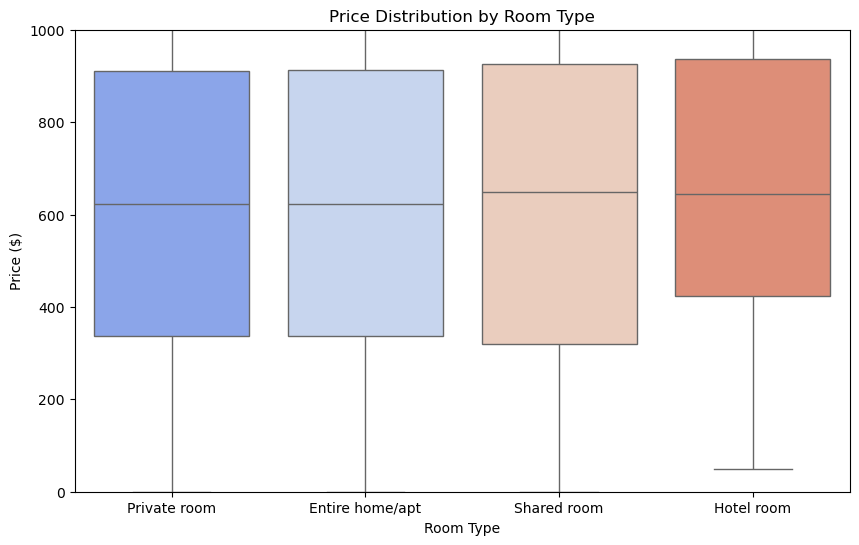

In [83]:
# Boxplot of price by room type
plt.figure(figsize=(10, 6))
sb.boxplot(x="room_type", y="price", data=df, palette="coolwarm")
plt.ylim(0, 1000)  # Limit price for better visualization
plt.title("Price Distribution by Room Type")
plt.xlabel("Room Type")
plt.ylabel("Price ($)")
plt.show()

**Price Distribution by Room Type**

*Hotel rooms have the highest median price, followed by entire homes/apartments and private rooms*

*Shared rooms have the lowest price range, making them the most budget-friendly option*

*Price variation is significant across all room types, but hotel rooms and entire homes/apartments show a wider range, suggesting luxury and budget options within the same category*

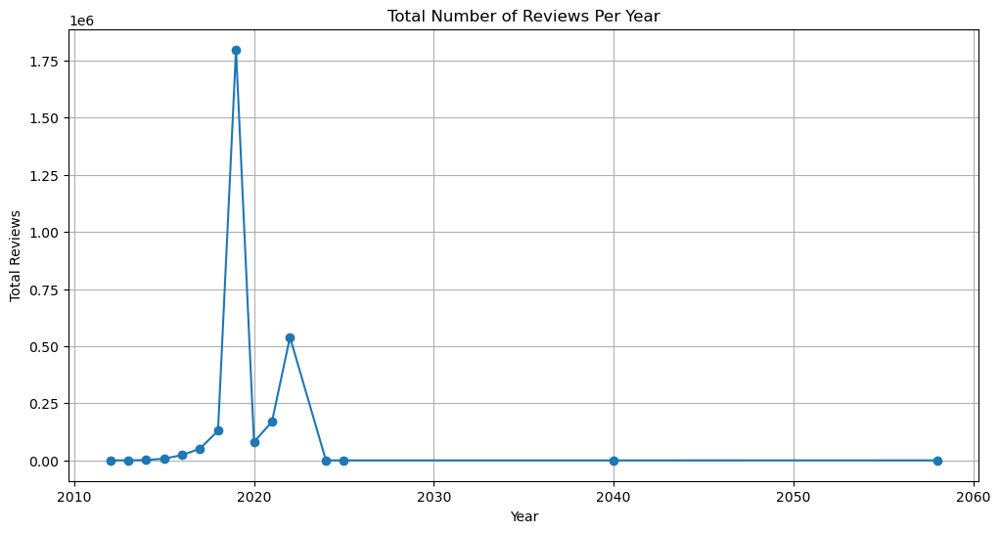

In [86]:
#Time-Based Analysis ----------------------
# Convert last_review to datetime
df['last_review'] = pd.to_datetime(df['last_review'], errors='coerce')

# Plot reviews trend over time
plt.figure(figsize=(12, 6))
df.groupby(df['last_review'].dt.year)['number_of_reviews'].sum().plot(marker='o')
plt.title("Total Number of Reviews Per Year")
plt.xlabel("Year")
plt.ylabel("Total Reviews")
plt.grid()
plt.show()

In [87]:
#Airbnb Listing Map
fig = pl.scatter_mapbox(df, lat='lat', lon='long', color='price', size='price',
                        hover_data=['neighbourhood', 'room_type', 'price'],
                        zoom=10, title='Airbnb Listings Map')
fig.update_layout(mapbox_style='open-street-map')
fig.show()

**Airbnb Listing Map**

*NYC has a high density of Airbnb listings, especially in Manhattan and Brooklyn, with higher prices in central areas. Listings are sparse in New Jersey, indicating lower demand*

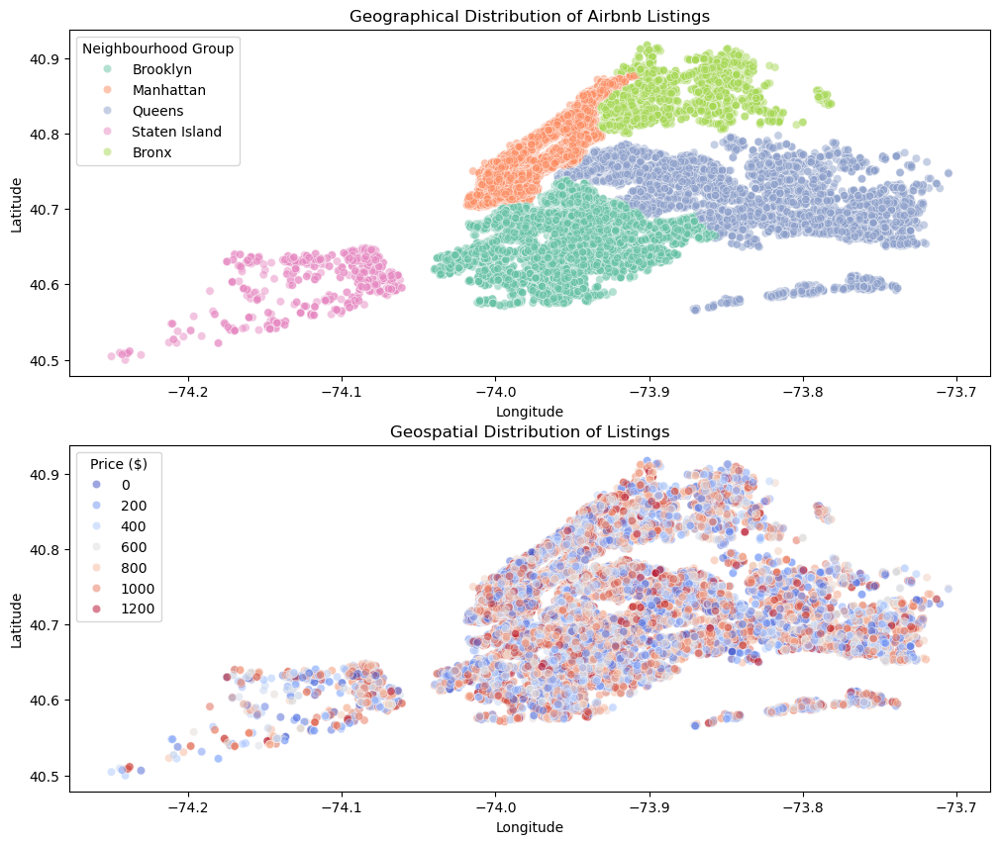

In [89]:
fig = plt.figure(figsize=(12,10))

plt.subplot(2,1,1)
sb.scatterplot(x='long', y='lat', hue='neighbourhood_group', data=df, alpha=0.5, palette='Set2')
plt.title('Geographical Distribution of Airbnb Listings')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.legend(title='Neighbourhood Group')


plt.subplot(2,1,2)
sb.scatterplot(x=df['long'], y=df['lat'], hue=df['price'], palette='coolwarm', alpha=0.5)
plt.title("Geospatial Distribution of Listings")
plt.xlabel("Longitude")
plt.ylabel("Latitude")
plt.legend(title="Price ($)")
plt.show()

**Geographical Distribution of Airbnb Listings**

*Different colors represent different neighborhood groups (Brooklyn, Manhattan, Queens, Staten Island, Bronx)*

*Manhattan and Brooklyn have the highest concentration of listings, especially in central areas*

*Queens and Bronx show moderate distribution, while Staten Island has the least density of Airbnb listings*

*The clustering pattern suggests tourist-heavy areas have more listings, while suburban regions have fewer options*

**Geospatial Distribution of Listings (Price-Based)**

*Each dot represents an Airbnb listing, with color indicating price (blue for lower, red for higher)*

*Higher-priced listings (red) are concentrated in central Manhattan, while cheaper listings (blue) are spread across Brooklyn, Queens, Bronx, and Staten Island*

*The density of listings is highest in Manhattan and Brooklyn, confirming their popularity among tourists*

*Sparse listings in Staten Island and parts of Queens indicate fewer Airbnb accommodations in those areas*

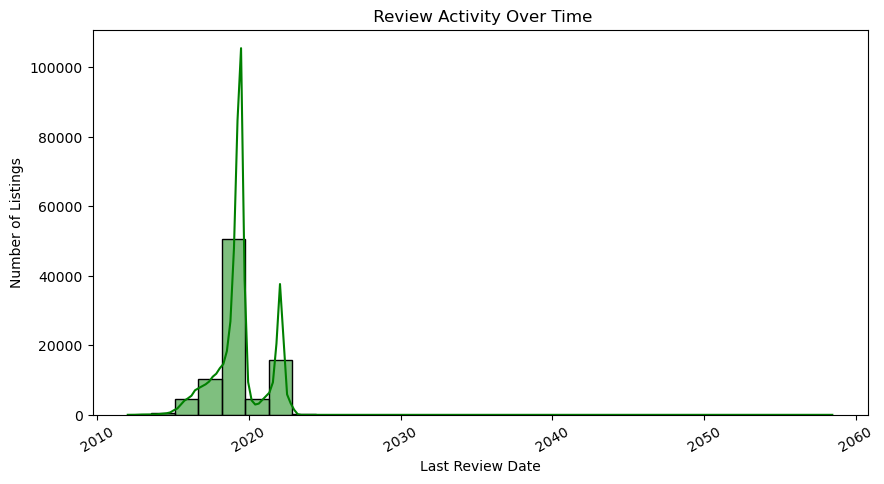

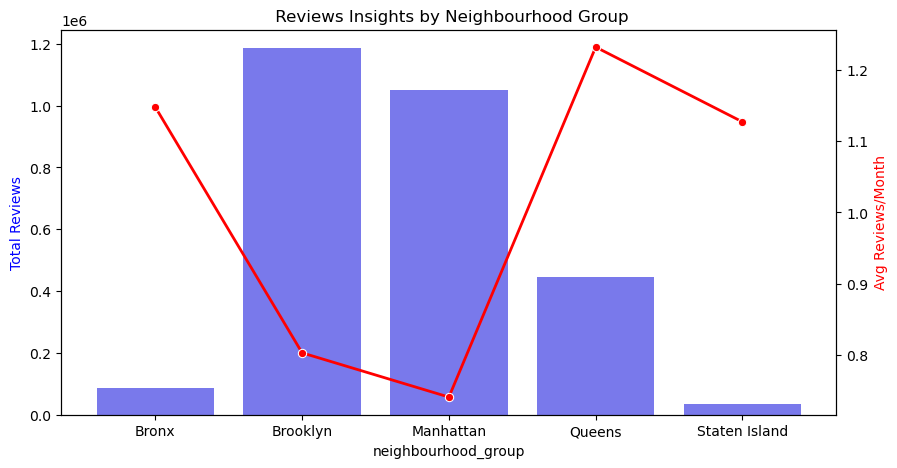

In [92]:
# Convert 'last_review' to datetime, drop missing values
df["last_review"] = pd.to_datetime(df["last_review"], errors="coerce")

review_insights = df.groupby("neighbourhood_group").agg({
    "number_of_reviews": "sum",
    "reviews_per_month": "mean"
}).reset_index()

# 📉 **Review Activity Over Time (Histogram)**
plt.figure(figsize=(10, 5))
sb.histplot(df["last_review"].dropna(), bins=30, kde=True, color="green")
plt.xlabel("Last Review Date"), plt.ylabel("Number of Listings")
plt.title(" Review Activity Over Time"), plt.xticks(rotation=30)
plt.show()

# 📊 **Total Reviews & Reviews Per Month (Bar + Line)**
fig, ax1 = plt.subplots(figsize=(10, 5))
sb.barplot(x="neighbourhood_group", y="number_of_reviews", data=review_insights, ax=ax1, color="blue", alpha=0.6)
ax2 = ax1.twinx()
sb.lineplot(x="neighbourhood_group", y="reviews_per_month", data=review_insights, ax=ax2, color="red", marker="o", linewidth=2)

# Labels & Title
ax1.set_ylabel("Total Reviews", color="blue"), ax2.set_ylabel("Avg Reviews/Month", color="red")
plt.title(" Reviews Insights by Neighbourhood Group")
plt.show()

**Review Activity Over Time**

*If analyzing Airbnb trends, focus on the 2018-2020 period, as it reflects the highest engagement*

*Investigate data quality to correct future-dated reviews*

*Consider external factors (pandemic, regulations, economic shifts) that could explain drops in activity*


**Reviews Insights by Neighbourhood Group**

*Brooklyn and Manhattan are the most reviewed areas overall, indicating their popularity for stays*

*Queens has a strong review frequency, suggesting steady engagement despite fewer total reviews*

*Staten Island and Bronx see the least activity, potentially due to lower tourist interest or fewer listings*

***Final Recommendations for Airbnb Business Based on KPI Analysis***


**Pricing Strategy**

*Hotel rooms have the highest median price, followed by entire homes/apartments and private rooms*

*Shared rooms are the most budget-friendly option, but their lower price range may not generate high revenue*

*There is a wide price variation in hotel rooms and entire homes, suggesting the need for clear segmentation of luxury vs. budget listings*

**Location-Based Optimization**

*Manhattan and Brooklyn have the highest density of Airbnb listings and command higher prices*

*Queens and Bronx show moderate distribution, with Staten Island having the least number of listings*

*Manhattan has the highest-priced listings, while cheaper accommodations are spread across Brooklyn, Queens, Bronx, and Staten Island*

*Opportunity: Invest in well-positioned properties in high-demand areas, especially in tourist-heavy zones*

**Market Demand and Review Activity**

*Review activity peaked between 2018-2020, indicating strong engagement during that period*

*Brooklyn and Manhattan are the most reviewed areas, confirming their popularity*

*Queens shows steady engagement, despite fewer total reviews, indicating potential for growth*

*Staten Island and Bronx have the least review activity, suggesting lower demand*

**Actionable Strategies**

*Dynamic Pricing: Use demand-based pricing in high-tourist areas, particularly in Manhattan and Brooklyn*

*Listing Optimization: Enhance descriptions, amenities, and images in high-competition areas*

*Customer Engagement: Encourage guest reviews to boost visibility in less-reviewed regions*

*Diversification: Consider targeting mid-range travelers by optimizing entire homes/apartments in Queens and the Bronx*

***Conclusion:***
*For sustainable growth, focus on high-demand locations (Manhattan, Brooklyn), optimize pricing strategies, and improve engagement through reviews. Expanding into moderately competitive areas like Queens can offer new revenue streams, while dynamic pricing and high-quality listings will maximize profitability.*